In [2]:
raster_path = '/Users/marcelofernandes/Library/CloudStorage/GoogleDrive-marcelo.fernandes@alumni.usp.br/.shortcut-targets-by-id/1M--OnzbTYagrNv5Ss9fjWlBxCMmasz-Y/10_Mestrado_2021_Marcelo Fernandes/4_Códigos/Qualificação/14_106.tif'

In [2]:
import rasterio
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np

In [4]:
# Abrir o arquivo raster
with rasterio.open(raster_path) as src:
    # Ler a primeira banda do arquivo raster
    band1 = src.read(1)
    # Obter os limites do raster
    bounds = src.bounds
    # Obter a resolução do raster
    resolution = src.res

# Criar um grid de coordenadas x e y
x = np.arange(bounds.left, bounds.right, resolution[0])
y = np.arange(bounds.top, bounds.bottom, -resolution[1])
x, y = np.meshgrid(x, y)

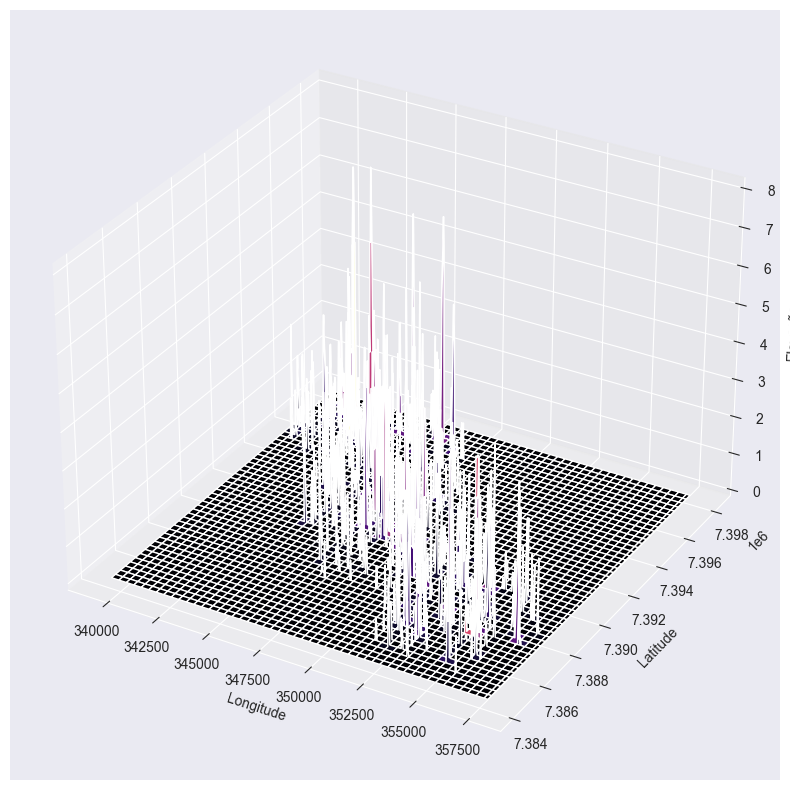

In [7]:

# Criar a figura e o eixo 3D
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection='3d')

# Plotar a superfície
ax.plot_surface(x, y, band1, cmap='magma')

# Adicionar rótulos aos eixos
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Elevação')

plt.show()


In [3]:
import rasterio
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio

# Abrir o arquivo raster
with rasterio.open(raster_path) as src:
    # Ler a primeira banda do arquivo raster
    band1 = src.read(1)
    # Obter os limites do raster
    bounds = src.bounds
    # Obter a resolução do raster
    resolution = src.res

# Criar um grid de coordenadas x e y
x = np.arange(bounds.left, bounds.right, resolution[0])
y = np.arange(bounds.top, bounds.bottom, -resolution[1])
x, y = np.meshgrid(x, y)

# Criar a superfície 3D
surface = go.Surface(z=band1, x=x, y=y, colorscale='Viridis')

# Configurar o layout
layout = go.Layout(
    title='Superfície 3D Interativa',
    scene=dict(
        xaxis=dict(title='Longitude'),
        yaxis=dict(title='Latitude'),
        zaxis=dict(title='Elevação')
    )
)

# Criar a figura

fig = go.Figure(data=[surface], layout=layout)

# Mostrar o gráfico
pio.show(fig)


In [18]:
import osmnx as ox
import rasterio
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio
from PIL import Image

In [19]:
# Substitua 'map_image.png' pelo caminho onde você deseja salvar a imagem do mapa
map_image_path = 'map_image.png'

# Abrir o arquivo raster
with rasterio.open(raster_path) as src:
    # Ler a primeira banda do arquivo raster
    band1 = src.read(1)
    # Obter os limites do raster
    bounds = src.bounds
    # Obter a resolução do raster
    resolution = src.res

# Criar um grid de coordenadas x e y
x = np.arange(bounds.left, bounds.right, resolution[0])
y = np.arange(bounds.top, bounds.bottom, -resolution[1])
x, y = np.meshgrid(x, y)

# Definir o CRS do mapa como WGS84 (EPSG:4326)
map_crs = 'EPSG:4326'

# Baixar o mapa da região correspondente ao raster usando OSMnx
north, south, east, west = bounds.top, bounds.bottom, bounds.right, bounds.left

# Converter os limites do raster para WGS84
west, south = transform(raster_crs, map_crs, [bounds.left], [bounds.bottom])
east, north = transform(raster_crs, map_crs, [bounds.right], [bounds.top])

bbox = (north, south, east, west)
graph = ox.graph_from_bbox(bbox=bbox, network_type='all')

NameError: name 'transform' is not defined

In [12]:

# Criar uma figura Matplotlib do mapa
fig, ax = ox.plot_graph(graph, show=False, close=False, save=False)
ax.set_extent(bbox)

# Salvar o mapa como uma imagem
fig.savefig(map_image_path, dpi=300, bbox_inches='tight')
plt.close(fig)

# Criar a superfície 3D
surface = go.Surface(z=band1, x=x, y=y, colorscale='Viridis')

# Configurar o layout
layout = go.Layout(
    title='Superfície 3D Interativa com Mapa de Fundo',
    scene=dict(
        xaxis=dict(title='Longitude', showbackground=True, backgroundcolor='rgba(0,0,0,0)'),
        yaxis=dict(title='Latitude', showbackground=True, backgroundcolor='rgba(0,0,0,0)'),
        zaxis=dict(title='Elevação')
    ),
    images=[dict(
        source=map_image_path,
        xref="x",
        yref="y",
        x=bounds.left,
        y=bounds.top,
        sizex=bounds.right - bounds.left,
        sizey=bounds.top - bounds.bottom,
        sizing="stretch",
        opacity=1.0,
        layer="below"
    )]
)

# Criar a figura
fig = go.Figure(data=[surface], layout=layout)

# Mostrar o gráfico
pio.show(fig)


/var/folders/8y/8z4lzw294m5c0kf05d8ww4r00000gn/T/ipykernel_44760/1136196391.py:21: FutureWarning:

The `north`, `south`, `east`, and `west` parameters are deprecated and will be removed in the v2.0.0 release. Use the `bbox` parameter instead. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123



TypeError: float() argument must be a string or a real number, not 'NoneType'

In [5]:
raster_DEM = '/Users/marcelofernandes/Library/CloudStorage/GoogleDrive-marcelo.fernandes@alumni.usp.br/.shortcut-targets-by-id/1M--OnzbTYagrNv5Ss9fjWlBxCMmasz-Y/10_Mestrado_2021_Marcelo Fernandes/8_Dados/DEM_Sao_Paulo.tif'

In [8]:
import rasterio
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio

# Abrir o arquivo raster
with rasterio.open(raster_DEM) as src:
    # Ler a primeira banda do arquivo raster
    band1 = src.read(1)
    # Obter os limites do raster
    bounds = src.bounds
    # Obter a resolução do raster
    resolution = src.res

# Criar um grid de coordenadas x e y
x = np.arange(bounds.left, bounds.right, resolution[0])
y = np.arange(bounds.top, bounds.bottom, -resolution[1])
x, y = np.meshgrid(x, y)

# Criar a superfície 3D
surface = go.Surface(z=band1, x=x, y=y, colorscale='Viridis')

# Configurar o layout
layout = go.Layout(
    title='Superfície 3D Interativa',
    scene=dict(
        xaxis=dict(title='Longitude'),
        yaxis=dict(title='Latitude'),
        zaxis=dict(title='Elevação')
    )
)

# Criar a figura
fig = go.Figure(data=[surface], layout=layout)

# Mostrar o gráfico
pio.show(fig)

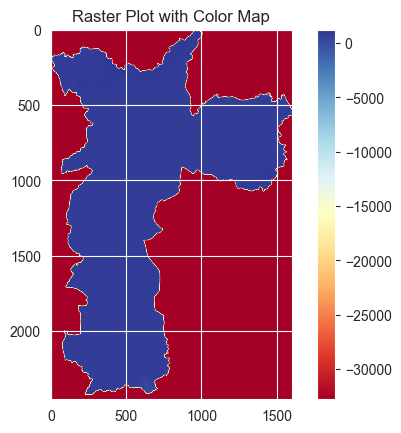

In [15]:
import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# Plot the raster data with a color map
plt.imshow(band1, cmap='RdYlBu')
plt.colorbar()
plt.title('Raster Plot with Color Map')
plt.show()

In [27]:
import rasterio
from rasterio.warp import calculate_default_transform, reproject, Resampling

# Caminho do arquivo raster original e do novo arquivo reprojetado
src_raster_path = raster_DEM
dst_raster_path = raster_DEM = '/Users/marcelofernandes/Library/CloudStorage/GoogleDrive-marcelo.fernandes@alumni.usp.br/.shortcut-targets-by-id/1M--OnzbTYagrNv5Ss9fjWlBxCMmasz-Y/10_Mestrado_2021_Marcelo Fernandes/8_Dados/DEM_Sao_Paulo_reproj.tif'

# Defina o novo sistema de coordenadas (CRS) usando um EPSG code
dst_crs = 'EPSG:4326'  # Exemplo: WGS84

# Abra o arquivo raster original
with rasterio.open(src_raster_path) as src:
    transform, width, height = calculate_default_transform(
        src.crs, dst_crs, src.width, src.height, *src.bounds)
    kwargs = src.meta.copy()
    kwargs.update({
        'crs': dst_crs,
        'transform': transform,
        'width': width,
        'height': height
    })

    # Crie um novo arquivo raster reprojetado
    with rasterio.open(dst_raster_path, 'w', **kwargs) as dst:
        for i in range(1, src.count + 1):
            reproject(
                source=rasterio.band(src, i),
                destination=rasterio.band(dst, i),
                src_transform=src.transform,
                src_crs=src.crs,
                dst_transform=transform,
                dst_crs=dst_crs,
                resampling=Resampling.nearest
            )
print("Reprojeção concluída e salva em", dst_raster_path)


Reprojeção concluída e salva em /Users/marcelofernandes/Library/CloudStorage/GoogleDrive-marcelo.fernandes@alumni.usp.br/.shortcut-targets-by-id/1M--OnzbTYagrNv5Ss9fjWlBxCMmasz-Y/10_Mestrado_2021_Marcelo Fernandes/8_Dados/DEM_Sao_Paulo_reproj.tif


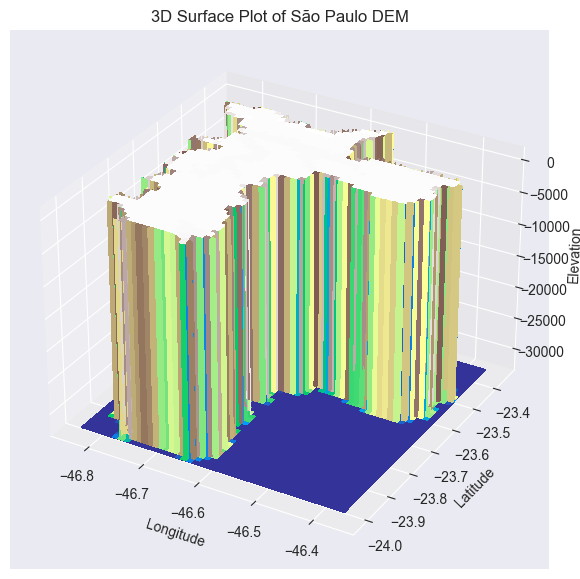

In [34]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Open the DEM file
dem_path = dst_raster_path
with rasterio.open(dem_path) as src:
    # Read the DEM data
    dem_data = src.read(1)
    # Get the coordinates of the pixels
    transform = src.transform
    x = np.arange(dem_data.shape[1])
    y = np.arange(dem_data.shape[0])
    x, y = np.meshgrid(x, y)
    x, y = rasterio.transform.xy(transform, y, x, offset='center')
    x = np.array(x)
    y = np.array(y)

# Plot the DEM data as a 3D surface
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x, y, dem_data, cmap='terrain', linewidth=0, antialiased=False)

# Definir os limites do eixo z para dar zoom
#min_elevation = -5000
#max_elevation = 00
#ax.set_zlim(min_elevation, max_elevation)  # Substitua min_elevation e max_elevation pelos valores desejados

# Add labels and title
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Elevation')
ax.set_title('3D Surface Plot of São Paulo DEM')

plt.show()

In [23]:
import rasterio
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio

# Configure Plotly to display in Jupyter Notebook (se necessário)
pio.renderers.default = 'notebook'

# Abra o arquivo DEM
dem_path = raster_DEM
with rasterio.open(dem_path) as src:
    # Leia os dados do DEM
    dem_data = src.read(1)
    # Obtenha as coordenadas dos pixels
    transform = src.transform
    x = np.arange(dem_data.shape[1])
    y = np.arange(dem_data.shape[0])
    x, y = np.meshgrid(x, y)
    x, y = rasterio.transform.xy(transform, y, x, offset='center')
    x = np.array(x)
    y = np.array(y)

In [25]:
# Crie o gráfico 3D interativo
surface = go.Surface(z=dem_data, x=x, y=y, colorscale='viridis')
layout = go.Layout(
    title='3D Surface Plot of São Paulo DEM',
    scene=dict(
        xaxis_title='Longitude',
        yaxis_title='Latitude',
        zaxis_title='Elevation'
    )
)
fig = go.Figure(data=[surface], layout=layout)

# Exiba o gráfico
fig.show()

In [ ]:
dem_data

In [21]:
import plotly.express as px
import numpy as np

z = np.random.rand(10, 10)
fig = px.imshow(z, color_continuous_scale='viridis')
fig.show()


In [1]:
raster_novo = '/Users/marcelofernandes/Downloads/s24_w047_1arc_v3.tif'

In [2]:
import rasterio

dem_path = raster_novo
try:
    with rasterio.open(dem_path) as src:
        print("Arquivo DEM aberto com sucesso.")
        dem_data = src.read(1)
except Exception as e:
    print(f"Erro ao abrir o arquivo DEM: {e}")


Arquivo DEM aberto com sucesso.


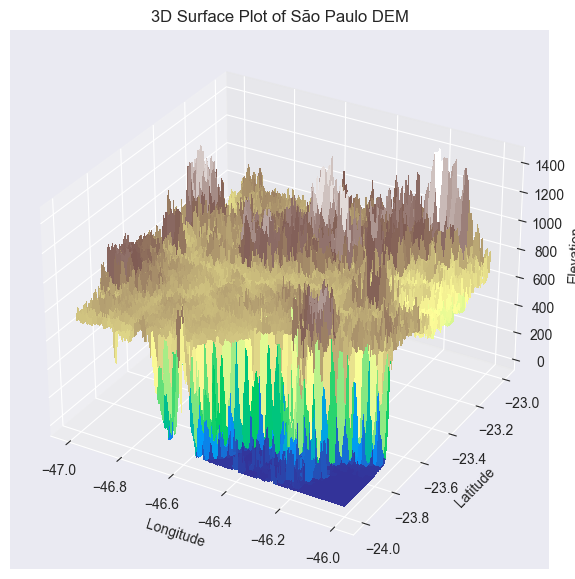

In [3]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Open the DEM file
dem_path = raster_novo
with rasterio.open(dem_path) as src:
    # Read the DEM data
    dem_data = src.read(1)
    # Get the coordinates of the pixels
    transform = src.transform
    x = np.arange(dem_data.shape[1])
    y = np.arange(dem_data.shape[0])
    x, y = np.meshgrid(x, y)
    x, y = rasterio.transform.xy(transform, y, x, offset='center')
    x = np.array(x)
    y = np.array(y)

# Plot the DEM data as a 3D surface
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x, y, dem_data, cmap='terrain', linewidth=0, antialiased=False)

# Definir os limites do eixo z para dar zoom
#min_elevation = -5000
#max_elevation = 00
#ax.set_zlim(min_elevation, max_elevation)  # Substitua min_elevation e max_elevation pelos valores desejados

# Add labels and title
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Elevation')
ax.set_title('3D Surface Plot of São Paulo DEM')

plt.show()

In [4]:
# Import necessary libraries
import pyvista as pv
import rioxarray as riox
import numpy as np
 
# Read the data from a DEM file
data = riox.open_rasterio(raster_novo)
data = data[0]
 
# Save the raster data as an array
values = np.asarray(data)
 
# Create a mesh grid
x, y = np.meshgrid(data['x'], data['y'])
 
# Set the z values and create a StructuredGrid
z = np.zeros_like(x)
mesh = pv.StructuredGrid(x, y, z)
 
# Assign Elevation Values
mesh["Elevation"] = values.ravel(order='F')
 
# Warp the mesh by scalar
topo = mesh.warp_by_scalar(scalars="Elevation", factor=0.000015)
 
# Plot the elevation map
p = pv.Plotter()
p.add_mesh(mesh=topo, scalars=topo["Elevation"], cmap='terrain')
p.show_grid(color='black')
p.set_background(color='white')
p.show(cpos="xy")

ModuleNotFoundError: No module named 'pyvista'